<a href="https://colab.research.google.com/github/judhacdc/PCVK_Genap_2023/blob/main/UTS_JudhaMaygustya_MahisaAghisniFadhli.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#PERSIAPAN

In [1]:
from google.colab import drive

drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
import numpy as np
import matplotlib.pyplot as plt
import cv2 as cv
import math
from google.colab.patches import cv2_imshow
from PIL import Image as im

#------------------WEEK 7----------------------- J

##Convolution Tanpa Library

In [69]:
def convolution2d(image, kernel, stride, padding):

#nilai piksel di sekitar tepi gambar diisi dengan nilai 0. Dengan demikian, 
#piksel-piksel pada tepi gambar tidak akan mempengaruhi hasil konvolusi. Hal ini 
#dilakukan dengan menggunakan padding mode='constant' dan constant_values=0 pada fungsi np.pad(). 
  image = np.pad(image, padding, mode='constant', constant_values=0)

#Mendapatkan ukuran kernel dengan menggunakan kernel.shape [Dimensi]
  kernel_height, kernel_width = kernel.shape
#Mendapatkan ukuran gambar yang telah ditambahkan padding menggunakan image.shape [Dimensi]
  padded_height, padded_width = image.shape

#Menghitung tinggi dan lebar dari output konvolusi yang akan dihasilkan
  output_height = (padded_height - kernel_height) // stride + 1
  output_width = (padded_width - kernel_width) // stride + 1

#membuat gambar kosongan yang sudah di sesuaikan ukurannya dengan proses sebelumnya 
  new_image = np.zeros((output_height, output_width)).astype(np.float32)

# Proses Konvolusi
  for y in range(0, output_height):
    for x in range(0, output_width):
      new_image[y][x] = np.sum(image[y * stride:y * stride + kernel_height, x * stride:x * stride + kernel_width] * kernel).astype(np.float32)
      
  return new_image

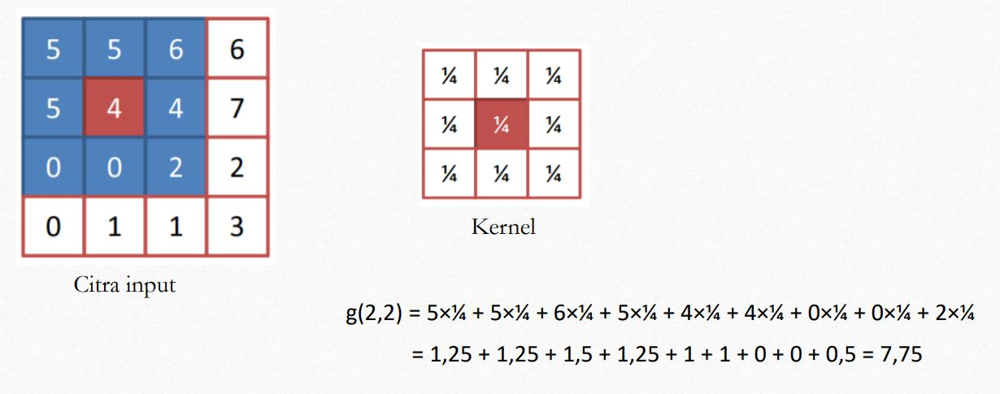

##Gambar ASLI

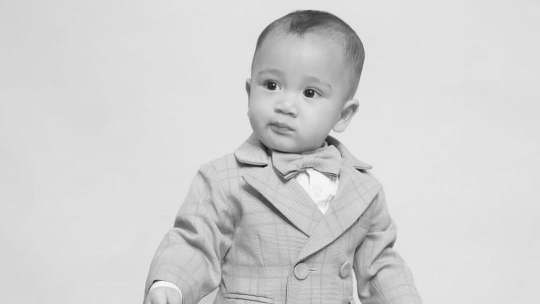

In [4]:
img_m = cv.imread('/content/drive/MyDrive/Images/CIPUNK.jpeg')
img_s = cv.resize(img_m, (0,0), fx=0.5, fy=0.5)
img_gray = cv.cvtColor(img_s, cv.COLOR_BGR2GRAY)
cv2_imshow(img_gray)

##SHARPEN

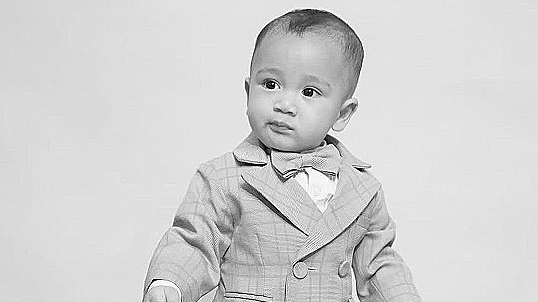

In [5]:
#  Kernel sharpen yang diberikan memiliki nilai 5 di tengah, yang menyebabkan nilai piksel di tengah kernel menjadi lebih tajam atau menonjol
#  angka 0 menunjukkan bahwa tidak ada pengaruh terhadap piksel tersebut, 
#  angka -1 menunjukkan bahwa piksel di sekelilingnya akan dikurangi. 
kernel_sharpen = np.array([[0,-1,0],
                            [-1,5,-1],
                            [0,-1,0]])
cv2_imshow(convolution2d(img_gray, kernel_sharpen, 1, 0))

##EMBOSS

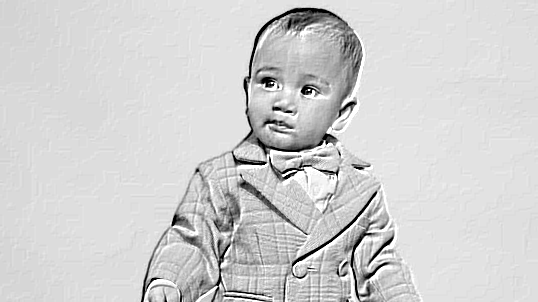

In [6]:
#Kernel emboss yang diberikan memiliki nilai -2 dan 2 di bagian ujung masing-masing, yang membuat piksel di ujung kernel menjadi lebih tajam atau menonjol
# nilai -1 dan 1 di sekelilingnya, yang menyebabkan perbedaan nilai piksel di sekitarnya dengan piksel ujung menjadi lebih besar.

kernel_emboss = np.array([[-2,-1,0],
                          [-1,1,1],
                          [0,1,2]])

cv2_imshow(convolution2d(img_gray, kernel_emboss, 1, 0))

##LEFT SOBEL EDGE DETECTION

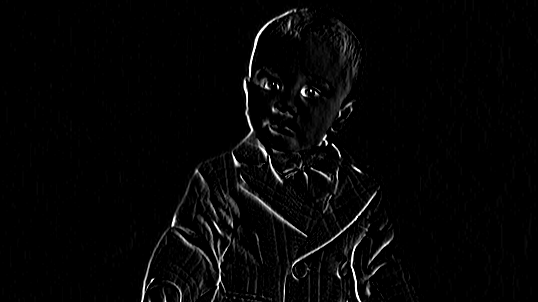

In [7]:
#Kernel Sobel ini memperhitungkan perbedaan nilai piksel pada baris 
#horizontal dan kolom vertikal. Dalam kernel tersebut, nilai 2 dan -2 menunjukkan perbedaan nilai piksel yang signifikan, 

kernel_sobel = np.array([[1,0,-1],
                         [2,0,-2],
                         [1,0,-1]])

cv2_imshow(convolution2d(img_gray, kernel_sobel, 1, 0))

##CANNY EDGE DETECTION

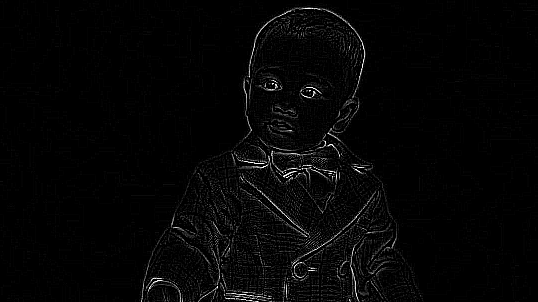

In [8]:
#Dalam kernel tersebut, nilai 8 menunjukkan bahwa piksel di tengah kernel lebih penting dibandingkan piksel di sekitarnya,
#sementara nilai -1 menunjukkan bahwa piksel di sekitarnya tidak terlalu berpengaruh. 
kernel_canny = np.array([[-1,-1,-1],
                         [-1,8,-1],
                         [-1,-1,-1]])

cv2_imshow(convolution2d(img_gray, kernel_canny, 1, 0))

##GUSSIAN BLUR

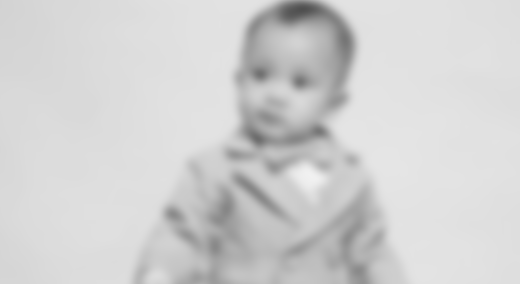

In [9]:
kernel_size = 21

#Menghitung sigma (standar deviasi) Gaussian yang akan digunakan berdasarkan ukuran kernel.
sigma = math.sqrt(kernel_size)

#Fungsi cv.getGaussianKernel() dari library OpenCV digunakan untuk menghasilkan kernel Gaussian 1D 
#dengan ukuran (kernel_size x 1) dan simpangan baku (sigma). 
gaussian_kernel = cv.getGaussianKernel(kernel_size, sigma)

#Untuk membuat kernel Gaussian 2D, kita mengalikan kernel 1D dengan transposenya
#menggunakan operator @. Kernel Gaussian 2D yang dihasilkan adalah hasil dari perkalian antara kernel 1D dengan dirinya sendiri yang telah ditranspose.
gauss_kernel = gaussian_kernel @ gaussian_kernel.transpose()

cv2_imshow(convolution2d(img_gray, gauss_kernel, 1, 0))

#------------------WEEK 6-----------------------

##Membuat Histogram Citra Secara Manual

height,widht dan depth pada gambar 609 1080 3


<BarContainer object of 256 artists>

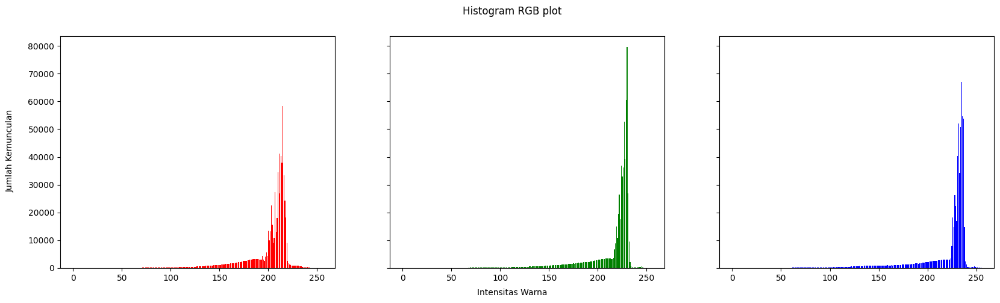

In [10]:
img = cv.imread('/content/drive/MyDrive/Images/CIPUNK.jpeg')

height, width, depth = np.shape(img)#Mengambil tinggi, lebar, dan kedalaman citra

names = np.arange(256)#Membuat sebuah array NumPy yang terdiri dari bilangan 0 sampai 255 (256 elemen) sebagai nama untuk sumbu x dari histogram.

#Membuat sebuah array NumPy yang terdiri dari bilangan 0 sampai 255 (256 elemen) sebagai nama untuk sumbu x dari histogram.
red = [0]*256
green = [0]*256
blue = [0]*256

# Menghitung histogram dari gambar menggunakan perulangan for. Setiap kali sebuah piksel diproses, nilai intensitas warna merah, hijau, dan biru dari piksel tersebut ditambahkan satu di array yang sesuai.
for y in range(height):
  for x in range(width):
    red[img[y][x][2]] += 1 # += digunakan untuk menambahkan nilai 1 pada elemen array yangmana untuk mengindikasikan bahwa nilai 100 muncul satu kali pada gambar
    green[img[y][x][1]] += 1
    blue[img[y][x][0]] += 1

# Membuat area subplots
fig, axs = plt.subplots(1, 3, figsize=[20,5], sharex=True, sharey=True)

fig.suptitle('Histogram RGB plot')
fig.text(0.08, 0.5, 'Jumlah Kemunculan', va='center', rotation='vertical')
fig.text(0.5, 0.02, 'Intensitas Warna', ha='center')

print('height,widht dan depth pada gambar' , height, width,depth)

# Membuat histogram untuk intensitas warna merah, hijau, dan biru pada subplot pertama, kedua, dan ketiga masing-masing.
axs[0].bar(names, red, color='red')
axs[1].bar(names, green, color='green')
axs[2].bar(names, blue, color='blue')


##Membuat Histogram Citra Dengan Library

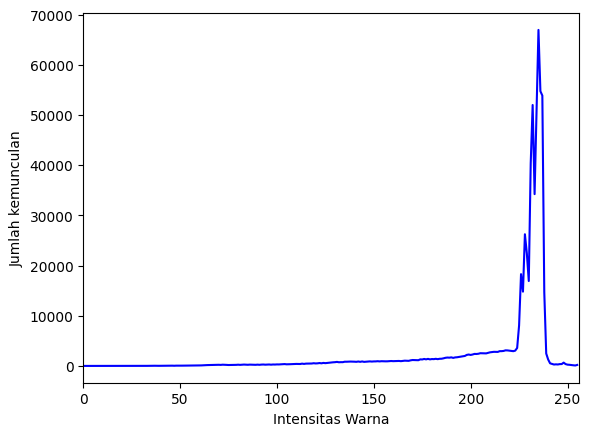

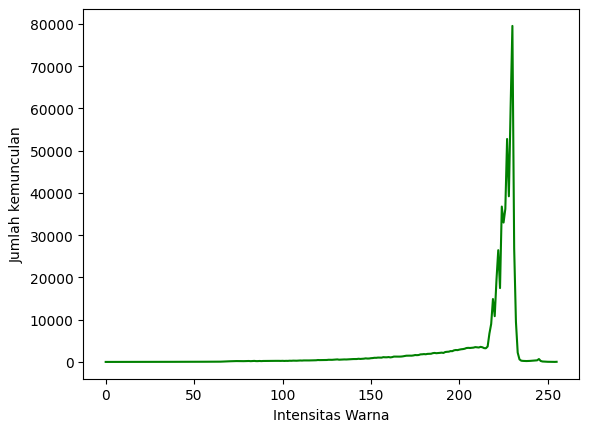

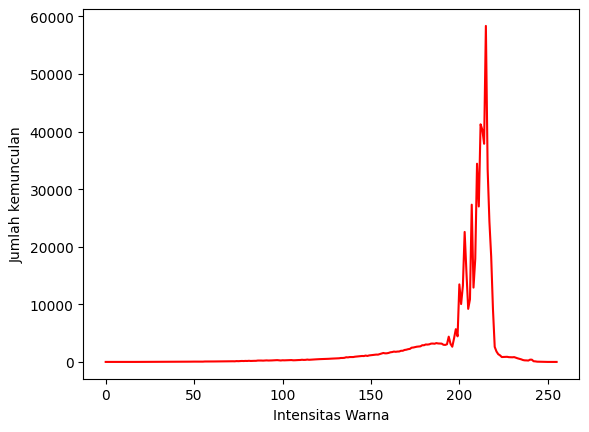

In [11]:
colors = ("b","g","r")
channel_ids = (0, 1, 2)

plt.xlim([0, 256])
for channel_id, c in zip(channel_ids, colors):
  histogram, bin_edges = np.histogram(
      img[:, :, channel_id], bins=256, range =(0,256)
  )
  plt.plot(bin_edges[0:-1], histogram, color=c)

  plt.xlabel("Intensitas Warna")
  plt.ylabel("Jumlah kemunculan")

  plt.show()

##Histogram equalization dan juga tampilan gambar sebelum dan sesudah proses histogram equalization

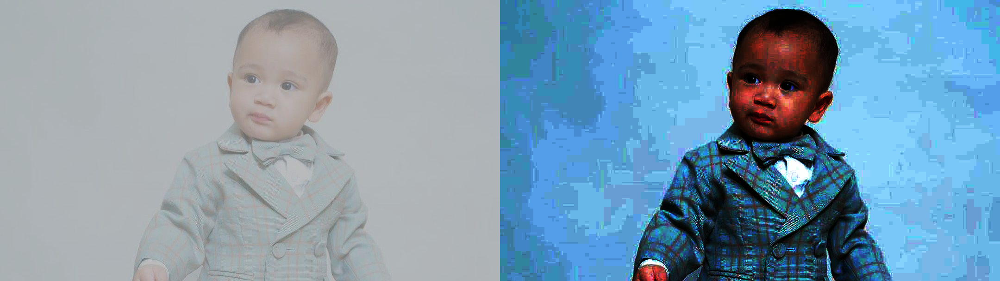

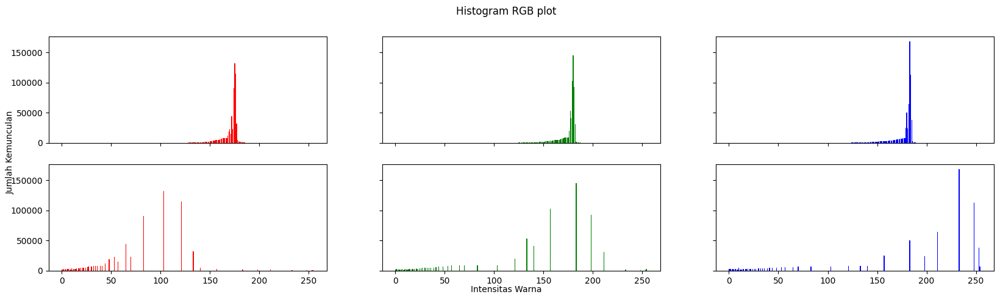

In [12]:
img = cv.imread('/content/drive/MyDrive/Images/CIPUNK_LC.jpg')
def histog(img):
  height, width, depth = np.shape(img) 
  ax = np.zeros((3,256)) #untuk menyimpan nilai pixel dalam tiga channel warna.
  for y in range(0,height) : 
    for x in range(0,width) :
      ax[0][img[y][x][0]] += 1 
      ax[1][img[y][x][1]] += 1
      ax[2][img[y][x][2]] += 1 
  return ax

histogram_asli = histog(img)

# Menconvert ke Numpy array
img_array = np.asarray(img)

#Menghitung histogram gambar 
histogram_array = np.bincount(img_array.flatten(), minlength=256)

# Menghitung jumlah total piksel pada gambar
# Normalisasi histogram dengan membagi setiap nilai histogram dengan jumlah total piksel pada gambar.
num_pixels = np. sum(histogram_array) 
histogram_array = histogram_array/num_pixels

# Normalized cumulative histogram 
cum_histo = np.cumsum(histogram_array)

#Membuat transformasi histogram dengan mengalikan cumulative histogram dengan 255 dan membulatkan ke bawah ke nilai integer. Kemudian hasilnya diubah tipe datanya menjadi unsigned integer 8-bit (np.uint8).
transform_map = np.floor(255 * cum_histo). astype (np.uint8)

# Mengonversi gambar yang berbentuk array 2D menjadi list 1D.
img_list = list(img_array.flatten())

# Membuat gambar baru yang telah di-equalisasi histogramnya dengan menggunakan nilai-nilai transformasi histogram yang telah dihitung.
eq_img_list = [transform_map[p] for p in img_list]

# reshape 
eq_img_array = np.reshape(np.asarray(eq_img_list), img_array.shape) 
img2 = eq_img_array

equal_histo = histog(img2)

final_frame = cv.hconcat((img, img2))
cv2_imshow(final_frame)

names = np.arange (256) 
isgrayimg = np.array_equal(blue, green, red) 
if (isgrayimg == False):
  fig, axs = plt.subplots(2, 3, figsize=[20,5], sharex=True, sharey=True) 
  fig.suptitle('Histogram RGB plot') 
  fig.text(0.09, 0.5, 'Jumlah Kemunculan', va='center', rotation='vertical') 
  fig.text(0.5, 0.04, 'Intensitas Warna', ha='center') 
  axs[0,0].bar(names, histogram_asli[2], color='red') 
  axs[0,1].bar(names, histogram_asli[1], color='green') 
  axs[0,2].bar(names, histogram_asli[0], color='blue') 
  axs[1,0].bar(names, equal_histo[2], color='red') 
  axs[1,1].bar(names, equal_histo[1], color='green')
  axs[1,2].bar(names, equal_histo[0], color='blue') 
else:
  fig, axs = plt. subplots(1, 2, figsize=[20,5], sharex=True, sharey=True) 
  fig. suptitle('Histogram RGB plot') 
  fig.text(0.09, 0.5, 'Jumlah Kemunculan', va='center', rotation='vertical') 
  fig.text(0.5, 0.94, 'Intensitas Warna', ha='center') 
  axs[0,0].bar(names, histogram_asli[2], color='gray') 
  axs[0,1].bar(names, equal_histo[2], color='gray')

Menggunakan library equalizeHist

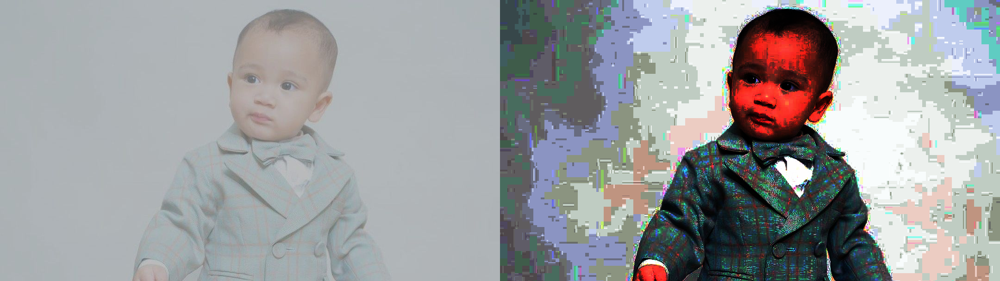

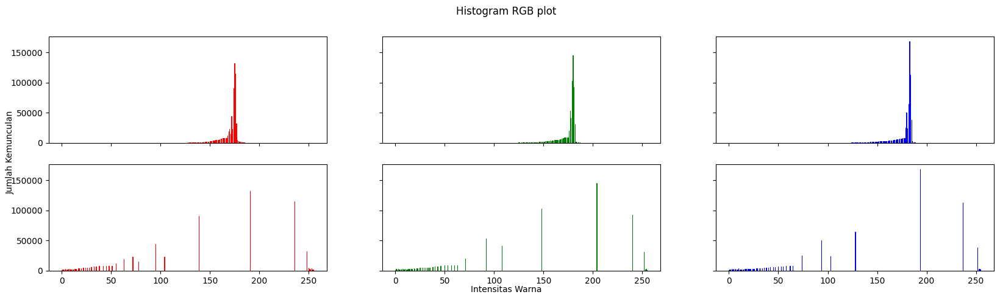

In [13]:
cipunk = cv.imread('/content/drive/MyDrive/Images/CIPUNK_LC.jpg')
channels = cv.split(cipunk)
eq_channels = []
for ch, color in zip(channels, ['R', 'G', 'B']):
  eq_channels.append(cv.equalizeHist(ch)) # Menggunakan library CV2 -> equalizeHist
eq_image = cv.merge(eq_channels)
equal_histo = histog(eq_image)

final_frame = cv.hconcat((cipunk, eq_image))
cv2_imshow(final_frame)

names = np.arange(256)
isgraying = np.array_equal(blue, green, red)
if (isgraying == False):
  fig, axs = plt.subplots(2, 3, figsize=[20,5], sharex=True, sharey =True)
  fig.suptitle('Histogram RGB plot')
  fig.text(0.09, 0.5, 'Jumlah Kemunculan', va='center', rotation='vertical')
  fig.text(0.5, 0.04, 'Intensitas Warna', ha='center')
  axs[0,0].bar(names, histogram_asli[2], color='red')
  axs[0,1].bar(names, histogram_asli[1], color='green')
  axs[0,2].bar(names, histogram_asli[0], color='blue')
  axs[1,0].bar(names, equal_histo[2], color='red')
  axs[1,1].bar(names, equal_histo[1], color='green')
  axs[1,2].bar(names, equal_histo[0], color='blue')
else:
  fig, axs = plt.subplots(1, 2, figsize=[20,5], sharex=True, sharey=True)
  fig.suptitle('Histogram RGB plot')
  fig.text(0.09, 0.5, 'Jumlah Kemunculan', va='center', rotation='vertical')
  fig.text(0.5, 0.04, 'Intensitas Warna', ha='center')
  axs[0,0].bar(names, histogram_asli[2], color='gray')
  axs[0,1].bar(names, equal_histo[2], color='gray')

Pemetaan 16 Juta warna RGB ke 8 warna saja

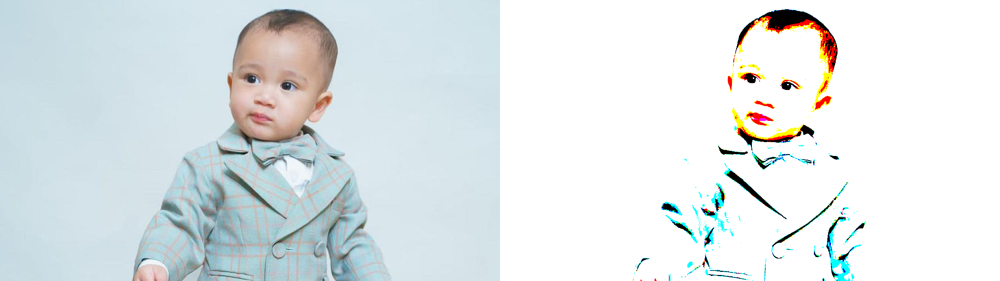

In [14]:
img = cv.imread('/content/drive/MyDrive/Images/CIPUNK.jpeg')
def warnaTerdekat (r, g, b): #merepresentasikan nilai dari warna rgb
  pValue = 0
  minDistance = 255*255 + 255*255 + 255*255 + 1 #nilai jarak Euclidean maksimum dan memastikan bahwa jarak antara warna yang sedang dicari dengan warna dalam palet tidak akan melebihi nilai minDistance.
  warnaPallette = [[0, 0, 0], [255, 0, 0], [0, 255, 0], [255, 255, 0], [0, 0, 255], [255, 0, 255], [0, 255, 255], [255, 255, 255]] #mendefinisikan 8 warna pada palet dan digunakan sebagai warna yang paling mendekati warna piksel pada gambar yang diolah
  for i in range(len(warnaPallette)): #melakukan perulangan untuk mengakses setiap warna dalam palet 
    rDiff = r - warnaPallette[i][0]
    gDiff = g - warnaPallette[i][1]
    bDiff = b - warnaPallette[i][2]
    distance = rDiff*rDiff + gDiff*gDiff + bDiff*bDiff #menghitung jarak Euclidean
    if (distance < minDistance):
      minDistance = distance
      pValue = i
  return pValue

warnaPallette = [[0, 0, 0], [255, 0, 0], [0, 255, 0], [255, 255, 0], [0, 0, 255], [255, 0, 255], [0, 255, 255], [255, 255, 255]]
img_16 = cv.cvtColor(img, cv.COLOR_BGR2RGB)
img_8 = np.zeros(img_16.shape, img_16.dtype)

for y in range(0, img_16.shape[0]):
  for x in range(0, img_16.shape[1]):
    baru = warnaTerdekat(img_16[y, x, 0], img_16[y, x, 1], img_16[y, x, 2])# mengakases nilai piksel
    img_8[y, x] = warnaPallette[baru]
    
img_16 = cv.cvtColor(img_16, cv.COLOR_BGR2RGB)
img_8 = cv.cvtColor(img_8, cv.COLOR_BGR2RGB)
final_frame = cv.hconcat((img_16, img_8))
cv2_imshow(final_frame)

##Proses dithering Floyd and Steinberg

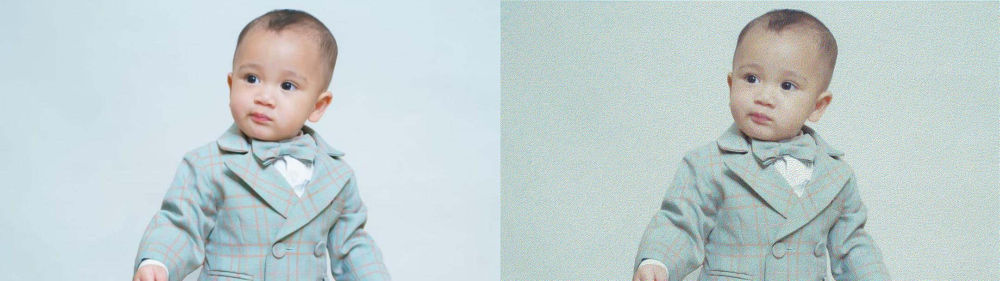

In [15]:
from google.colab.patches import cv2_imshow
import cv2 as cv  
import numpy as np

image = cv.imread('/content/drive/MyDrive/Images/CIPUNK.jpeg')
b, g, r = cv.split(image)

# menerapkan dithering ke chanel
for channel in [b, g, r]:
    height, width = channel.shape

    # inisialisasi image
    new_channel = np.zeros((height, width), dtype=np.uint8)

    for y in range(height):
        for x in range(width):
            old_value = channel[y, x]
            new_value = 0

            if old_value > 128:
                new_value = 255

            channel[y, x] = new_value

            error = old_value - new_value

            if x < width - 1:
                new_number = channel[y, x + 1] + error * 7 / 16
                if new_number > 255:
                    new_number = 255
                elif new_number < 0:
                    new_number = 0
                channel[y, x + 1] = new_number

            if x > 0 and y < height - 1:
                new_number = channel[y + 1, x - 1] + error * 3 / 16
                if new_number > 255:
                    new_number = 255
                elif new_number < 0:
                    new_number = 0
                channel[y + 1, x - 1] = new_number

            if y < height - 1:
                new_number = channel[y + 1, x] + error * 5 / 16
                if new_number > 255:
                    new_number = 255
                elif new_number < 0:
                    new_number = 0
                channel[y + 1, x] = new_number

            if y < height - 1 and x < width - 1:
                new_number = channel[y + 1, x + 1] + error * 1 / 16
                if new_number > 255:
                    new_number = 255
                elif new_number < 0:
                    new_number = 0
                channel[y + 1, x + 1] = new_number

    # Store dithered channel in new image
    new_channel = channel

# Merge channels into final image
new_image = cv.merge([b, g, r])

# Display original and dithered images

final_frame = cv.hconcat((image, new_image))
cv2_imshow(final_frame)

Menggunakan cipunk.jpeg rubah menjadi grey image, kemudian terapkan histogram 
equalization sehingga terjadi perbaikan sebaran warna pada citra. Setelah itu dari hasil histogram equalization implementasikan proses dithering Floyd and Steinberg

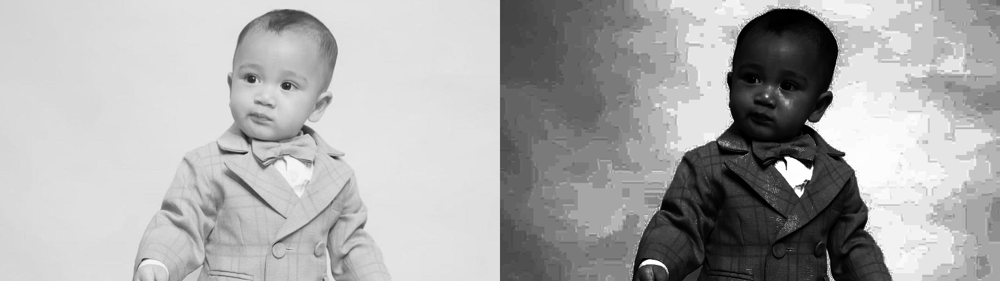

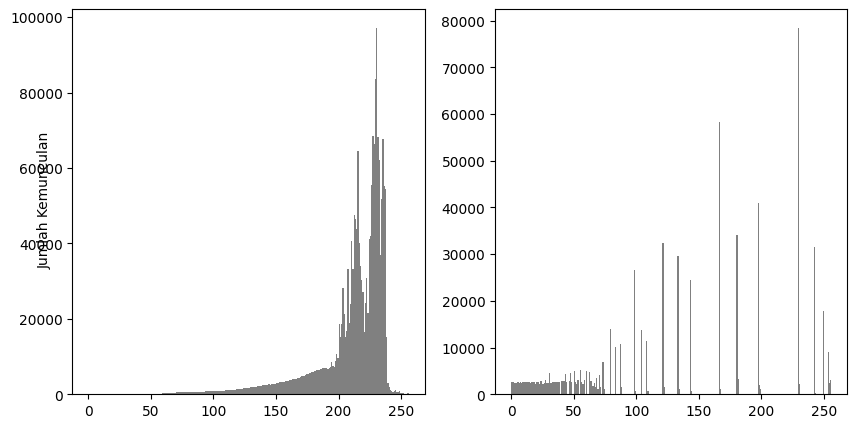

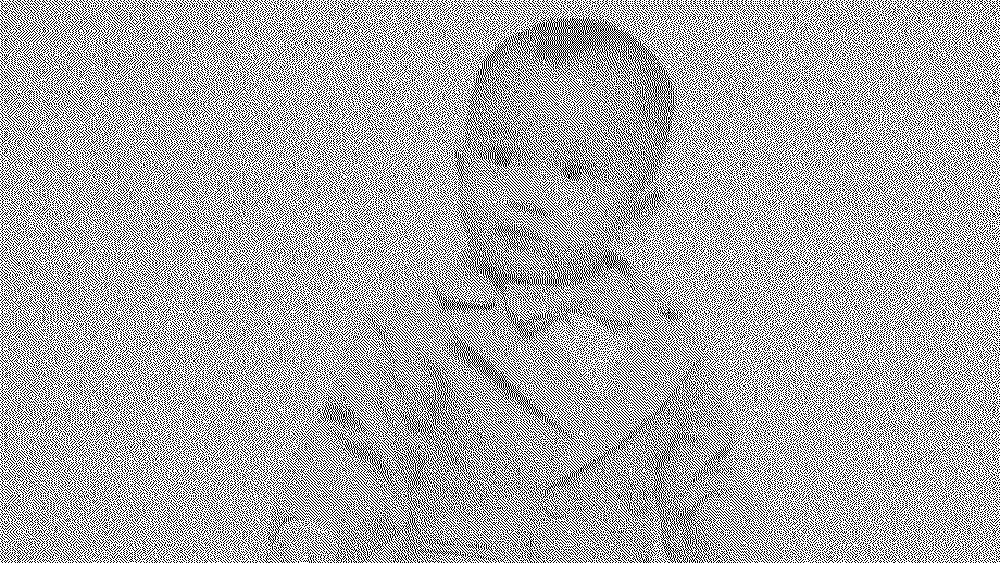

In [16]:
from PIL import Image
import cv2

Image = cv.imread('/content/drive/MyDrive/Images/CIPUNK_LC.jpg')

FloydSteinberg = cv2.cvtColor(Image, cv2.COLOR_BGR2GRAY)

def histog(img):
    height, width = img.shape
    hist = np.zeros(256)
    for y in range(height):
        for x in range(width):
            pixel = img[y, x]
            hist[pixel] += 1
    return hist

def equalize_histogram(img):
    height, width = img.shape #Mengambil dimensi gambar untuk digunakan pada iterasi berikutnya.
    hist = histog(img)
    cdf = np.cumsum(hist)#Menghitung kumulatif histogram.
    cdf_normalized = cdf / (height*width)#Normalisasi kumulatif histogram dengan membaginya dengan jumlah pixel pada gambar.
    transform_map = np.floor(255 * cdf_normalized).astype(np.uint8)#Membuat peta transformasi dengan memetakan nilai piksel pada gambar yang lama ke nilai piksel yang baru.
    img_eq = np.zeros((height, width), dtype=np.uint8) #Membuat gambar baru yang akan menampung gambar hasil ekualisasi histogram.
    for y in range(height):# Iterasi pada setiap piksel pada gambar lama, kemudian mengganti nilai piksel tersebut pada gambar baru dengan menggunakan nilai piksel yang baru pada peta transformasi.
        for x in range(width):
            img_eq[y, x] = transform_map[img[y, x]]
    return img_eq

# implementasikan proses dithering Floyd and Steinberg
Height = FloydSteinberg.shape[0]
Width = FloydSteinberg.shape[1]

for y in range(0, Height):
    for x in range(0, Width):

        old_value = FloydSteinberg[y, x]
        new_value = 0 
        if (old_value > 128) : #jika nilai old_value lebih besar dari 128, new_value akan diatur sebagai 255
            new_value = 255

        FloydSteinberg[y, x] = new_value

        Error = old_value - new_value
        #Pada setiap piksel tersebut, nilai piksel dihitung kembali dengan memperhatikan error dari piksel sebelumnya dan koefisien tertentu (7/16, 3/16, 5/16, dan 1/16) yang sudah ditentukan.
        if (x<Width-1): #piksel bukan berada di tepi kanan gambar dan langkah selanjutnya akan dilakukan untuk piksel di sebelah kanan.
            NewNumber = FloydSteinberg[y, x+1] + Error * 7 / 16
            if (NewNumber>255) : NewNumber=255
            elif (NewNumber<0) : NewNumber=0
            FloydSteinberg[y, x+1] = NewNumber

        if (x>0 and y<Height-1):#piksel tidak berada di tepi kiri atau bawah gambar dan langkah selanjutnya akan dilakukan untuk piksel di sudut kiri bawah.
            NewNumber = FloydSteinberg[y+1, x-1] + Error * 3 / 16
            if (NewNumber>255) : NewNumber=255
            elif (NewNumber<0) : NewNumber=0
            FloydSteinberg[y+1, x-1] = NewNumber

        if (y<Height-1): #piksel tidak berada di tepi bawah gambar dan langkah selanjutnya akan dilakukan untuk piksel di bawah.
            NewNumber= FloydSteinberg[y+1, x] + Error * 5 / 16
            if (NewNumber>255) : NewNumber=255
            elif (NewNumber<0) : NewNumber=0
            FloydSteinberg[y+1, x] = NewNumber

        if (y<Height-1 and x<Width-1): #piksel tidak berada di tepi kanan atau bawah gambar dan langkah selanjutnya akan dilakukan untuk piksel di sudut kanan bawah.
            NewNumber = FloydSteinberg[y+1, x+1] + Error * 1 / 16
            if (NewNumber>255) : NewNumber=255
            elif (NewNumber<0) : NewNumber=0
            FloydSteinberg[y+1, x+1] = NewNumber



img_gray = cv.cvtColor(image, cv.COLOR_BGR2GRAY)
img_eq = equalize_histogram(img_gray)

cv2.imwrite('/content/drive/MyDrive/Images/cipunk_eq.jpg', img_eq)

imgeq = cv.imread('/content/drive/MyDrive/Images/cipunk_eq.jpg', cv.IMREAD_GRAYSCALE)

# Apply histogram equalization
equalized = cv.equalizeHist(imgeq)

# Calculate the histogram of the original image
hist_orig, bins = np.histogram(image.flatten(), 256, [0,256])

# Apply histogram equalization
equalized = cv.equalizeHist(imgeq)

# Calculate the histogram of the equalized image
hist_eq, bins = np.histogram(equalized.flatten(), 256, [0,256])


# final_frame = cv.hconcat((img_gray, img_eq, FloydSteinberg))
final_frame = cv.hconcat((img_gray, img_eq))
cv2_imshow(final_frame)

# Display the histograms using Matplotlib
fig, axs = plt.subplots(1, 2, figsize=(10,5))
fig.text(0.09, 0.5, 'Jumlah Kemunculan', va='center', rotation='vertical') 
axs[0].hist(image.flatten(), 256, [0,256], color='gray')
axs[1].hist(equalized.flatten(), 256, [0,256], color='gray')
plt.show()


cv2_imshow(FloydSteinberg)

In [17]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


#------------------WEEK 5----------------------- J

##Gamma Correction


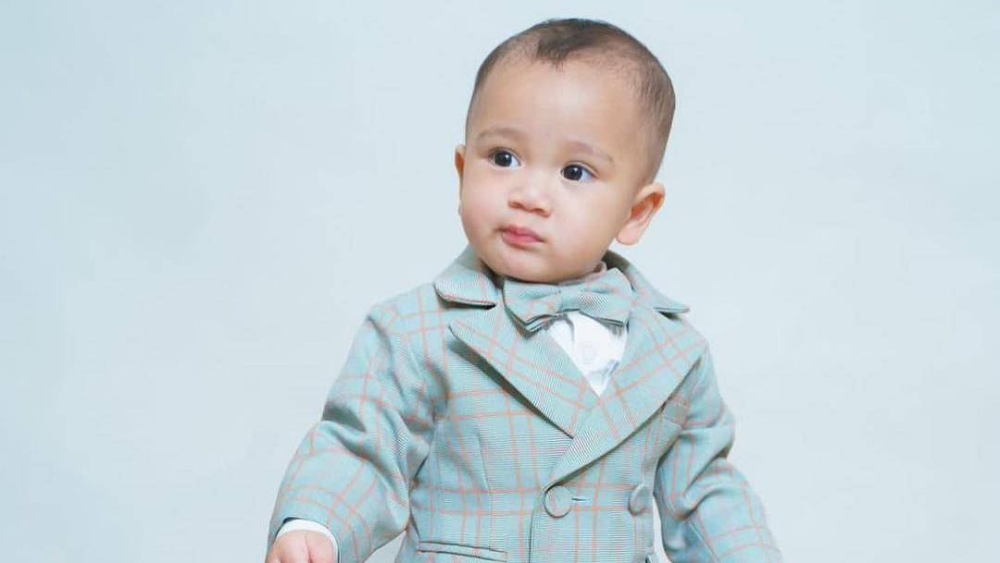

In [18]:
#import image
import cv2 as cv 
from google.colab.patches import cv2_imshow 
from skimage import io 
import matplotlib.pyplot as plt 
import numpy as np 

week5 = cv.imread('/content/drive/MyDrive/Images/CIPUNK.jpeg')
#print original image
cv2_imshow(week5)

##Gamma Correction

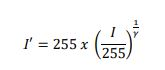

 Gamma Correction pada citra 
----------------------------------
Masukkan nilai Gamma: 2


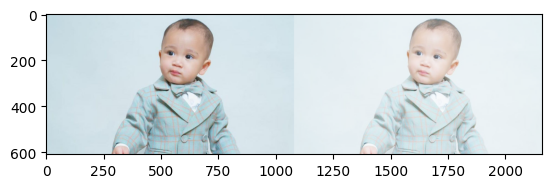

In [19]:
print(' Gamma Correction pada citra ')
print('----------------------------------')
try: 
  gamma = int(input('Masukkan nilai Gamma: '))
except ValueError:
  print('Error, not a number')

original = cv.cvtColor(week5,cv.COLOR_BGR2RGB)
gamma_image = np.zeros(original.shape, original.dtype)

for y in range(original.shape[0]):
  for x in range(original.shape[1]):
    for c in range(original.shape[2]):

#Rumus

     gamma_image[y,x,c] = np.clip(255 * pow(original[y,x,c] / 255, (1 / gamma)), 0, 255)
     
final_frame = cv.hconcat((original, gamma_image))
plt.imshow(final_frame)

##Simulasi Image Depth

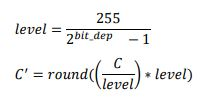

 Bit Depth pada Citra [STATIS]
---------------------------------


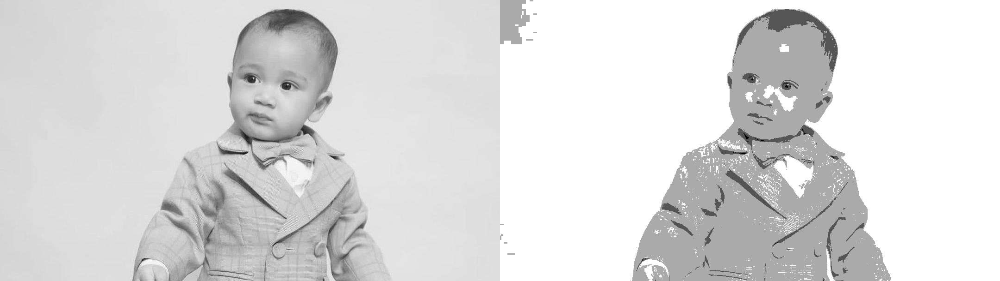

In [20]:
print(' Bit Depth pada Citra [STATIS]')
print('---------------------------------')

bit_depth=2
level = 255 / (pow(2,bit_depth)-1) 
original = cv.imread("/content/drive/MyDrive/Images/CIPUNK.jpeg", cv.IMREAD_GRAYSCALE)

bit_depth_image = np.zeros(original.shape, original.dtype)

#akses per piksel -> hanya 2 loop karena greyscale hanya 2 matriks
for y in range(original.shape[0]):
  for x in range(original.shape[1]):

#Rumus
       bit_depth_image[y,x] = np.clip(round(original[y,x] / level) * level, 0, 255)

final_frame = cv.hconcat((original, bit_depth_image))
cv2_imshow(final_frame)

 Bit Depth pada Citra [DINAMIS]
---------------------------------
Masukkan nilai bit depth: 2


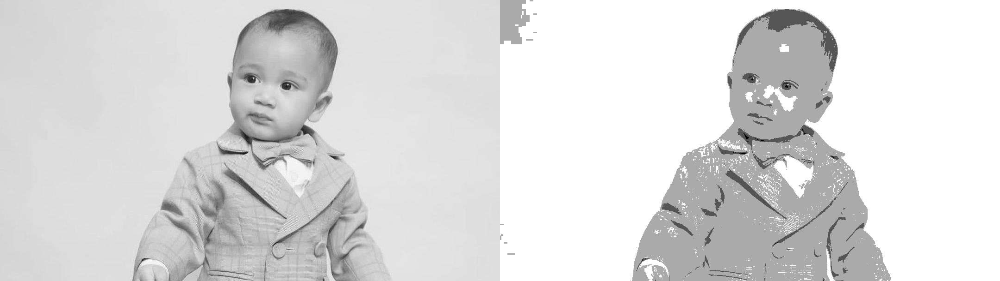

In [21]:
print(' Bit Depth pada Citra [DINAMIS]')
print('---------------------------------')

try:
  bd = float(input('Masukkan nilai bit depth: '))
except ValueError:
  print('Error, not a number')

bit_depth = 2**bd
level = 255 / (bit_depth - 1)



original = cv.imread("/content/drive/MyDrive/Images/CIPUNK.jpeg", cv.IMREAD_GRAYSCALE)

bit_depth_image = np.zeros(original.shape, original.dtype)

#akses per piksel -> hanya 2 loop karena greyscale hanya 2 matriks
for y in range(original.shape[0]):
  for x in range(original.shape[1]):
       bit_depth_image[y,x] = np.clip(round(original[y,x] / level) * level, 0, 255)

final_frame = cv.hconcat((original, bit_depth_image))
cv2_imshow(final_frame)

##Average Denoising

RUMUS PSNR
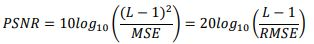

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Average Denoising 30 citra
------------------------
Nilai PSNR: 28.543263558803076 dB


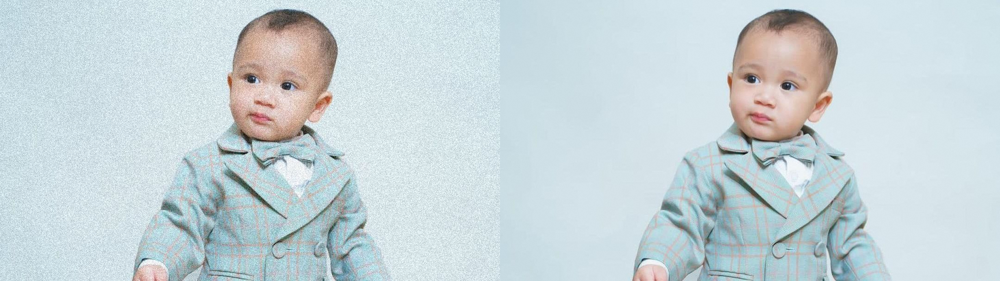

In [22]:
import glob
from math import log10, sqrt

import cv2 as cv

from google.colab import drive
drive.mount('/content/drive')

print('Average Denoising 30 citra')
print('------------------------')

img_amt = 30

#Rumus - PPT halaman 5
def PSNR(ori, compressed):
  mse = np.mean((ori - compressed) ** 2)
  if(mse == 0):
    return 100
  max_pixel = 255.0
  psnr = 20 * log10(max_pixel / sqrt(mse))
  return psnr

ori = cv.imread('/content/drive/MyDrive/Images/CIPUNK_NOISE.jpeg')
denoising_avg = np.zeros(ori.shape, ori.dtype)

cv_img = []
for i in glob.glob('/content/drive/MyDrive/Images/Noise_Cipunk/*.jpeg'):
  n = cv.imread(i)
  cv_img.append(n)

#Rumus AVG Denoising
denoising_avg = np.mean(cv_img[:img_amt], axis=0).astype(np.uint8)

value = PSNR(ori, denoising_avg)
print(f"Nilai PSNR: {value} dB")

final_frame = cv.hconcat((ori, denoising_avg))
cv2_imshow(final_frame)


##Image Masking

resolusi image : height x width  609  x  1080


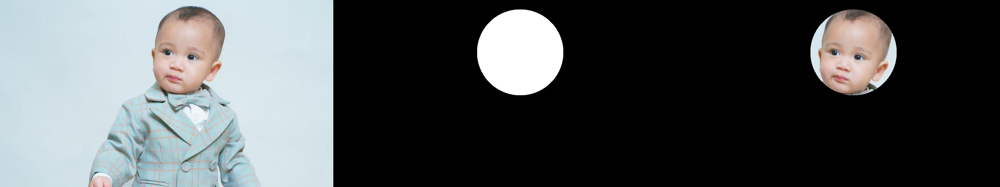

In [23]:
img_t = cv.imread('/content/drive/MyDrive/Images/CIPUNK.jpeg')

height = img_t.shape[0]
width = img_t.shape[1]
print("resolusi image : height x width ", height, " x ",width)

mask = np.zeros(img_t.shape, img_t.dtype)

mask = cv.circle(mask, (605, 170), 140, (255,255,255), -1)
result = img_t & mask

final_frame = cv.hconcat((img_t, mask, result))
cv2_imshow(final_frame)

In [24]:
#import gambar yang akan di gunakan terlebih dahulu untuk operasi" operator berikut ini
img_cipung = cv.imread('/content/drive/MyDrive/Images/CIPUNK.jpeg')

##OR

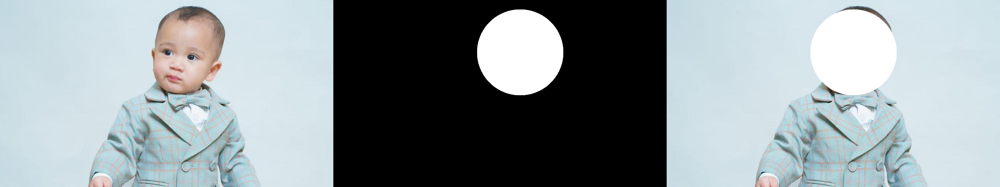

In [25]:
mask = np.zeros(img_cipung.shape, dtype=np.uint8)
mask = cv.circle(mask, (605, 170), 140, (255,255,255), -1)

masked = img_cipung | mask

rose_frame = cv.hconcat((img_cipung, mask, masked))
cv2_imshow(rose_frame)

##NOT

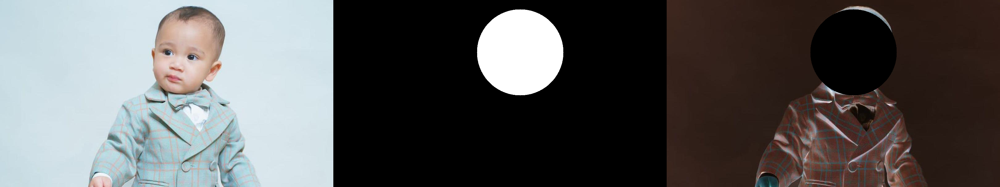

In [26]:
mask = np.zeros(img_cipung.shape, dtype=np.uint8)
mask = cv.circle(mask,  (605, 170), 140, (255,255,255), -1)

masked = ~img_cipung & ~mask

rose_frame = cv.hconcat((img_cipung, mask, masked))
cv2_imshow(rose_frame)

##NAND

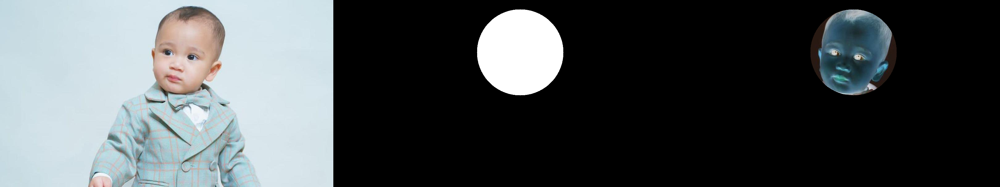

In [27]:
mask = np.zeros(img_cipung.shape, dtype=np.uint8)
mask = cv.circle(mask, (605, 170), 140, (255,255,255), -1)

masked = ~img_cipung & mask

rose_frame = cv.hconcat((img_cipung, mask, masked))
cv2_imshow(rose_frame)

##XOR

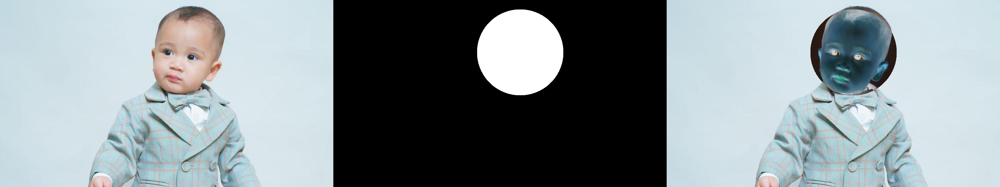

In [28]:
mask = np.zeros(img_cipung.shape, dtype=np.uint8)
mask = cv.circle(mask, (605, 170), 140, (255,255,255), -1)

masked = img_cipung ^ mask

rose_frame = cv.hconcat((img_cipung, mask, masked))
cv2_imshow(rose_frame)

##AND

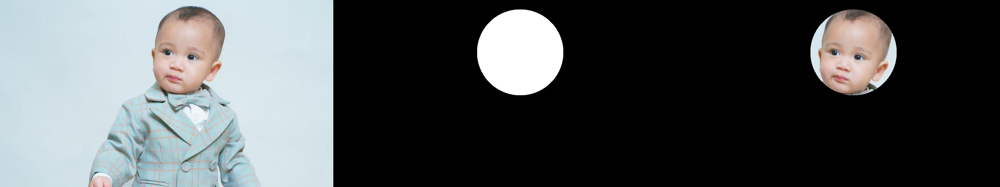

In [29]:
mask = np.zeros(img_cipung.shape, dtype=np.uint8)
mask = cv.circle(mask, (605, 170), 140, (255,255,255), -1)

masked = img_cipung & mask

rose_frame = cv.hconcat((img_cipung, mask, masked))
cv2_imshow(rose_frame)

#------------------WEEK 3-----------------------

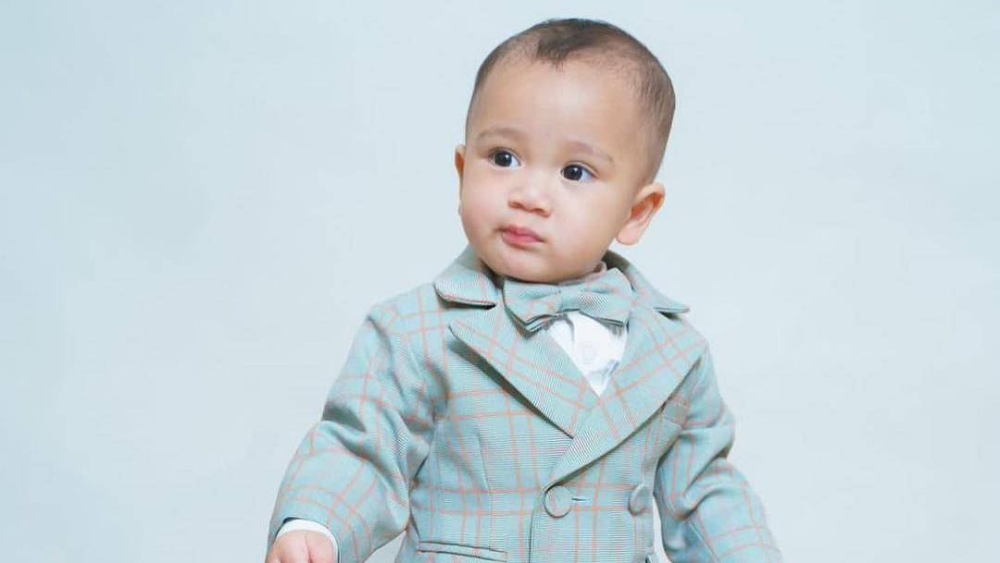

In [30]:
img = cv.imread("/content/drive/MyDrive/Images/CIPUNK.jpeg")
cv2_imshow(img)

Implementasikan transformasi contrast

Rumus = 𝑔(𝑥, 𝑦) = 𝑎 ∗ 𝑓(𝑥, 𝑦) + b

Mengubah tingkat kecerahan citra
--------------------------------
Masukkan nilai kecerahan: 2
Masukkan Kontras [1.0-3.0]: 1


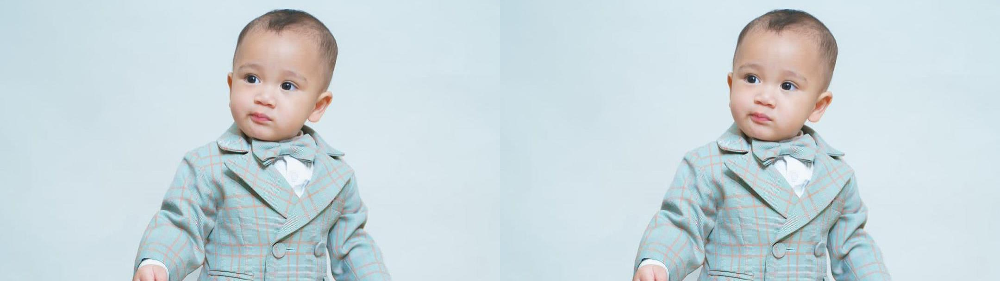

In [31]:
print('Mengubah tingkat kecerahan citra')
print('--------------------------------')
try:
  brightness = int(input('Masukkan nilai kecerahan: '))
  contrast = float(input('Masukkan Kontras [1.0-3.0]: '))
except ValueError:
  print('Error, not a number')

original = cv.imread('/content/drive/MyDrive/Images/CIPUNK.jpeg')
brightness_image = np.zeros(original.shape, original.dtype)

#access for each pixel
for y in range(original.shape[0]):
  for x in range(original.shape[1]):
    for c in range(original.shape[2]):
      brightness_image[y,x,c] = np.clip(contrast*original[y,x,c] + brightness, 0, 255) # Mengakses piksel pada koordinat (y,x) dan channel c pada citra brightness_image.
      #Menghitung nilai kontras dan kecerahan pada setiap piksel pada citra asli dengan cara mengalikan nilai piksel asli dengan kontras dan
      # menambahkannya dengan nilai kecerahan yang dimasukkan oleh user.

final_frame = cv.hconcat((original, brightness_image))
cv2_imshow(final_frame)

Implementasikan transformasi logarithmic brightness

Rumus 𝑠 = 𝑐 ∗ 𝑙𝑜𝑔(1 + 𝑟)

 Mengubah tingkat kecerahan citra dengan Transformasi Log 
----------------------------------------------------------
Masukan nilai kecerahan: 2


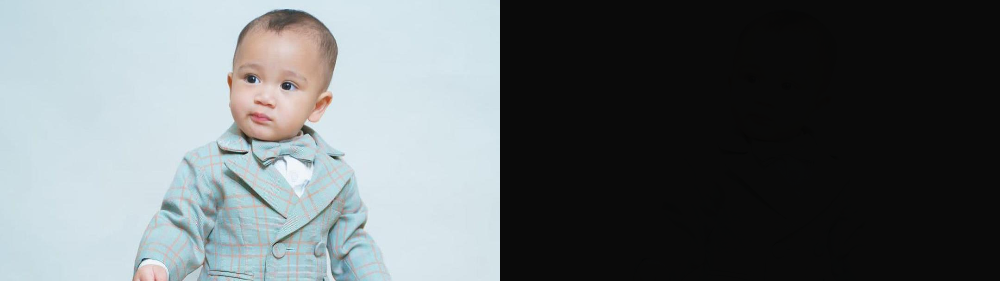

In [32]:
print(' Mengubah tingkat kecerahan citra dengan Transformasi Log ')
print('----------------------------------------------------------')

try:
  brightness = int(input('Masukan nilai kecerahan: '))
except ValueError:
  input('Error, not a number')

brightness_image = np.zeros(original.shape, original.dtype)

for y in range(original.shape[0]):
  for x in range(original.shape[1]):
    for c in range(original.shape[2]):
      brightness_image[y,x,c] = np.clip(brightness * (np.log(1 + original[y,x,c])), 0 , 255)
      #Menghitung nilai kecerahan pada setiap piksel pada citra asli dengan menggunakan fungsi logaritma. Kemudian nilai tersebut akan dibatasi antara 0 dan 255.
final_frame = cv.hconcat((original, brightness_image))
cv2_imshow(final_frame)

##Grayscale Averaging

𝐺𝑟𝑎𝑦𝑠𝑐𝑎𝑙𝑒𝑎𝑣𝑔 = (𝑅 + 𝐺 + 𝐵)/3

Averaging


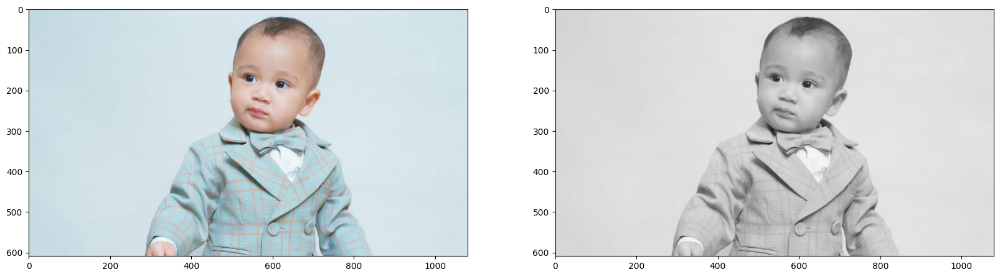

In [33]:
image3 = cv.imread('/content/drive/MyDrive/Images/CIPUNK.jpeg')
averaging_image3 = np.zeros(image3.shape, image3.dtype)

image3 = cv.cvtColor(image3, cv.COLOR_BGR2RGB)

#Akses per piksel
for y in range(image3.shape[0]):
  for x in range(image3.shape[1]):
    blue = image3.item(y,x,0)
    green = image3.item(y,x,1)
    red = image3.item(y,x,2)
    average = (blue + green + red) / 3
    averaging_image3[y,x] = [average, average, average]#menetapkan nllai yang sudah dihitung setiap channel
    

print('Averaging')
fig, ax = plt.subplots(1,2, figsize=(20,20))
ax[0].imshow(image3)
ax[1].imshow(averaging_image3)

##Lightness

𝐺𝑟𝑎𝑦𝑠𝑐𝑎𝑙𝑒𝐿𝑖𝑔ℎ𝑡𝑛𝑒𝑠𝑠 = max[𝑅, 𝐺, 𝐵] + min[𝑅, 𝐺, 𝐵]/2

Lightness


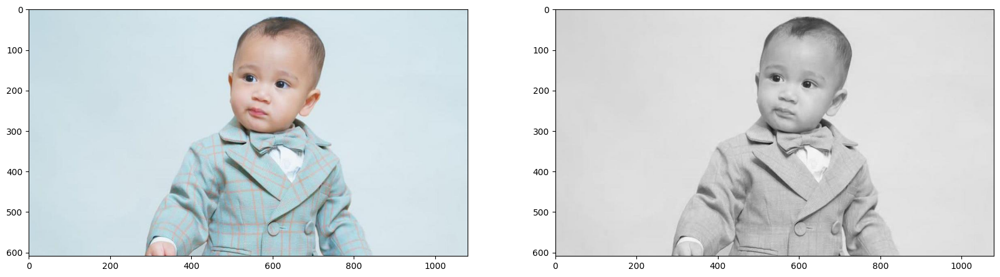

In [34]:
image3 = cv.imread('/content/drive/MyDrive/Images/CIPUNK.jpeg')
lightness_image3 = np.zeros(image3.shape, image3.dtype)

image3 = cv.cvtColor(image3, cv.COLOR_BGR2RGB)

#Akses per piksel
for y in range(image3.shape[0]):
  for x in range(image3.shape[1]):
    blue = image3.item(y,x,0)
    green = image3.item(y,x,1)
    red = image3.item(y,x,2)
    maxBGR = max(blue,green,red)
    minBGR = min(blue, green, red)
    lightness_value = (maxBGR + minBGR) / 2
    lightness_image3[y,x] = [lightness_value, lightness_value, lightness_value]
    
print('Lightness')
fig, ax = plt.subplots(1,2, figsize=(20,20))
ax[0].imshow(image3)
ax[1].imshow(lightness_image3)

##Luminance

Luminance


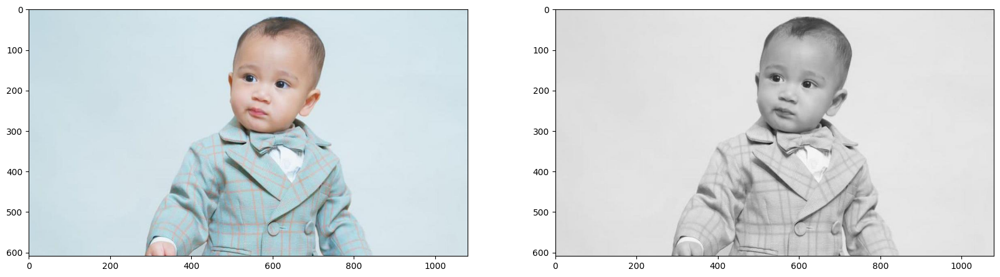

In [35]:
image3 = cv.imread('/content/drive/MyDrive/Images/CIPUNK.jpeg')
luminance_image3 = np.zeros(image3.shape, image3.dtype)

image3 = cv.cvtColor(image3, cv.COLOR_BGR2RGB)

#Akses per piksel
for y in range(image3.shape[0]):
  for x in range(image3.shape[1]):
    blue = image3.item(y,x,0)
    green = image3.item(y,x,1)
    red = image3.item(y,x,2)
    maxBGR = max(blue,green,red)
    minBGR = min(blue, green, red)
    luminance_value = 0.21 * red + 0.72 * green + 0.07 * blue
    luminance_image3[y,x] = [luminance_value, luminance_value, luminance_value]
    
  
print('Luminance')
fig, ax = plt.subplots(1,2, figsize=(20,20))
ax[0].imshow(image3)
ax[1].imshow(luminance_image3)

##Menampilkan warna tertentu

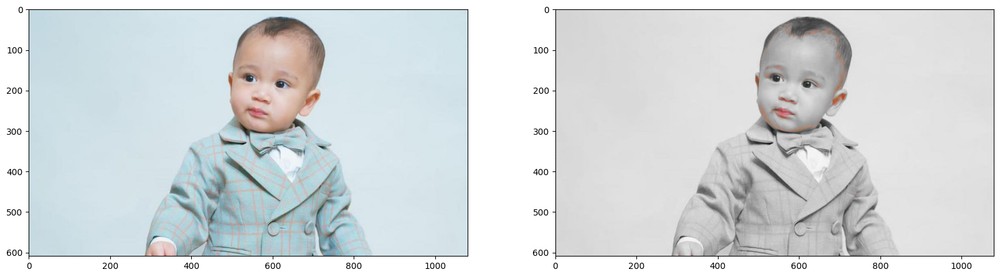

In [38]:
original = cv.imread('/content/drive/MyDrive/Images/CIPUNK.jpeg')
img_rgb = cv.cvtColor(original,cv.COLOR_BGR2RGB)

one_color = np.array(img_rgb)
for y in range(img_rgb.shape[0]):
    for x in range(img_rgb.shape[1]):
        if (one_color[y,x,0] < 150 or one_color[y,x,1] > 140): #memeriksa chanel merah kurang dari 150 atau nilai pixel hijau lebih dari 140 jika terpenuhi maka dieksekusi
            one_color[y,x]= np.mean(one_color[y,x])# one_color[y,x] merujuk pada nilai warna untuk pixel di baris y dan kolom x pada citra.
            #jika statement terpennuhi maka nilai piksel di titik tersebut akan diganti dengan rata-rata nilai piksel di sekitarnya.

fig, ax = plt.subplots(1,2, figsize=(20,20))
ax[0].imshow(img_rgb)
ax[1].imshow(one_color)

#------------------WEEK 2----------------------- J

##Persiapan

In [39]:
from google.colab import drive

# akses ke google drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [40]:
import cv2 as cv
from google.colab.patches import cv2_imshow
from skimage import io
import matplotlib.pyplot as plt
import numpy as np

##Import & Tampilkan dalam bentuk BGR

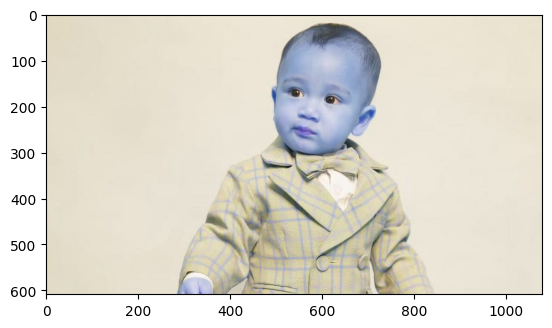

In [41]:
img = cv.imread ('/content/drive/MyDrive/Images/CIPUNK.jpeg')
#show dengan plt biar BGR
plt.imshow(img)

##Ubah ke RGB

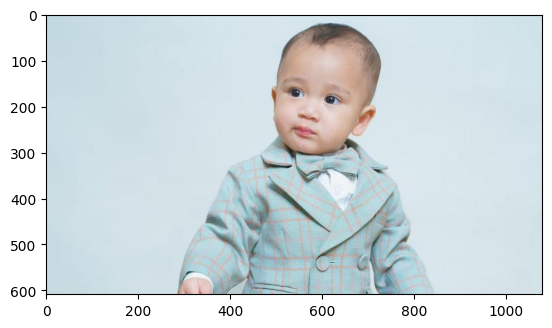

In [42]:
#Ubah ke RGB
img3 = cv.cvtColor(img,cv.COLOR_BGR2RGB)
plt.imshow(img3)

##Greyscale CV

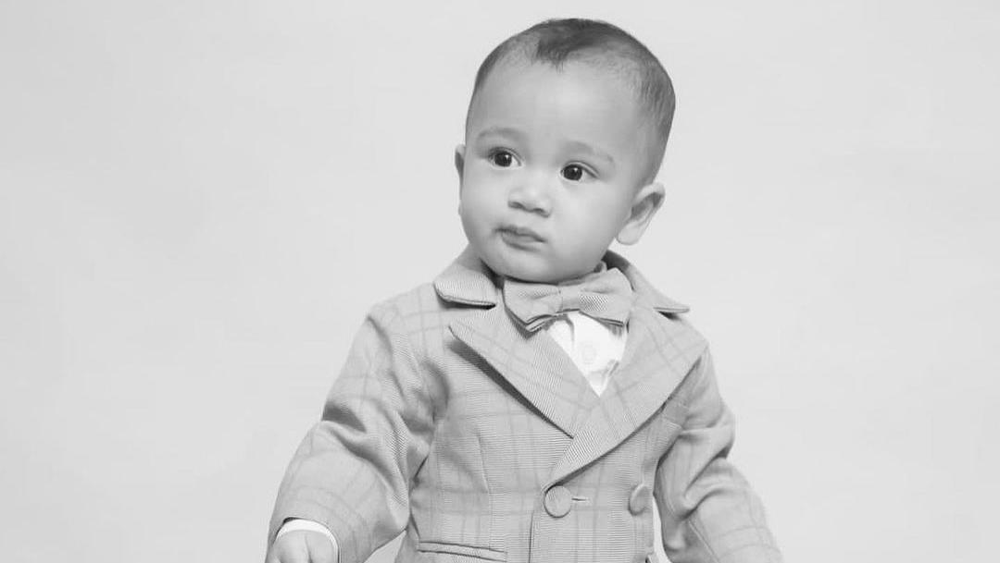

In [43]:
#ubah ke grayscale dengan open cv
img_gray = cv.imread ('/content/drive/MyDrive/Images/CIPUNK.jpeg' , cv.IMREAD_GRAYSCALE)
cv2_imshow(img_gray)

##Greyscale PLT

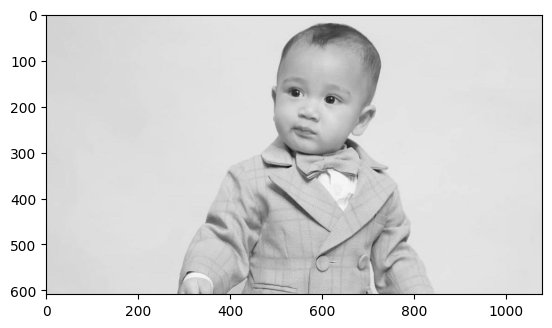

In [44]:
import cv2 as cv
#Ubah ke greyscale dengan menggunakan plt
im = cv.imread('/content/drive/MyDrive/Images/CIPUNK.jpeg')

# mengubah format warna gambar dari BGR menjadi RGB
im = cv.cvtColor(im, cv.COLOR_BGR2RGB)

# mengubah gambar menjadi grayscale
gray = cv.cvtColor(im, cv.COLOR_RGB2GRAY)

# menampilkan gambar grayscale menggunakan Matplotlib
plt.imshow(gray, cmap='gray')
plt.show()

##Resize Image

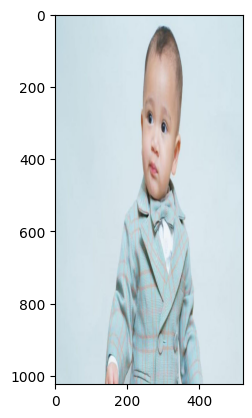

In [45]:
import cv2 as cv
img111 = cv.imread('/content/drive/MyDrive/Images/CIPUNK.jpeg')
img4 = cv.resize(cv.cvtColor(img111,cv.COLOR_BGR2RGB),(521,1024))
plt.imshow(img4)

##Balik Gambar

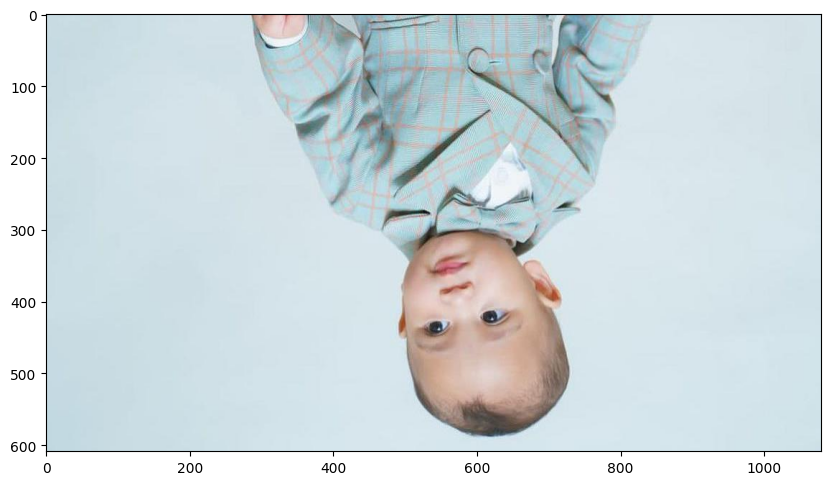

In [46]:
import cv2 as cv
img222 = cv.imread('/content/drive/MyDrive/Images/CIPUNK.jpeg')

#balik dengan cv.flip
img5 = cv.flip (cv.cvtColor(img222,cv.COLOR_BGR2RGB),0)

#print
fig = plt.figure(figsize=(10,10))
ax = fig.add_subplot(111)
ax.imshow(img5)

##Buat Kotak 

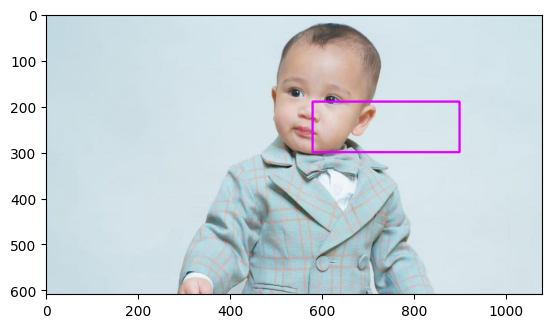

In [47]:
import cv2 as cv
img = cv.imread('/content/drive/MyDrive/Images/CIPUNK.jpeg')
img5 =cv.cvtColor(img,cv.COLOR_BGR2RGB)

cv.rectangle(img5, pt1=(580,190), pt2 = (900,300), color= (225,0,255), thickness=3)

plt.imshow(img5)

##Buat Lingkaran

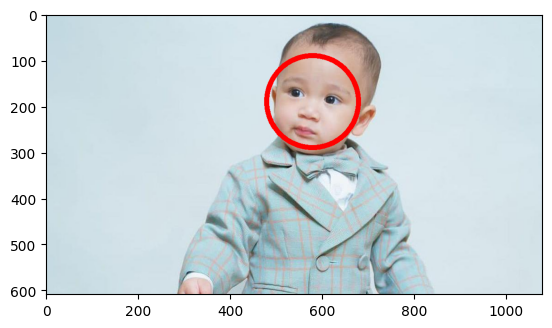

In [48]:
#Library
import cv2 as cv
img = cv.imread('/content/drive/MyDrive/Images/CIPUNK.jpeg')
img5 =cv.cvtColor(img,cv.COLOR_BGR2RGB)
cv.circle(img5, center=(580,190),radius=100, color= (255,0,0), thickness=10)

plt.imshow(img5)

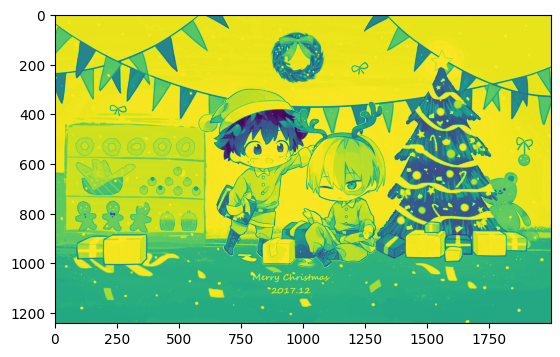

In [49]:
#channel red only
import cv2 as cv
import matplotlib.pyplot as plt

# membaca gambar
img = cv.imread('/content/drive/MyDrive/Images/img01.jpg')

# mengambil channel red saja
img_g = img[:, :, 2]

# menampilkan gambar dalam channel red saja menggunakan Matplotlib
plt.imshow(img_g)
plt.show()

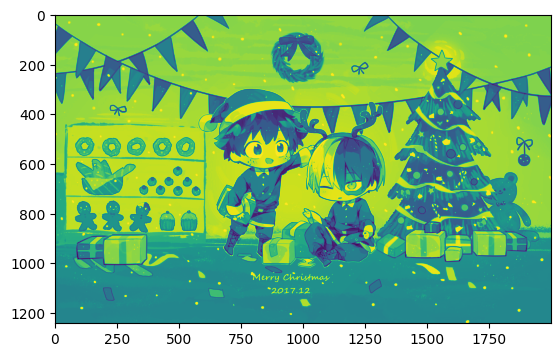

In [50]:
#chanel green only
import cv2 as cv
import matplotlib.pyplot as plt

# membaca gambar
img = cv.imread('/content/drive/MyDrive/Images/img01.jpg')

# mengambil channel green saja
img_g = img[:, :, 1]

# menampilkan gambar dalam channel green saja menggunakan Matplotlib
plt.imshow(img_g)
plt.show()


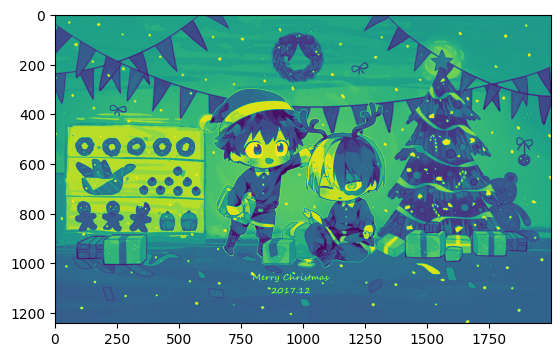

In [51]:
#channel blue only
import cv2 as cv
import matplotlib.pyplot as plt

# membaca gambar
img = cv.imread('/content/drive/MyDrive/Images/img01.jpg')

# mengambil channel blue saja
img_g = img[:, :, 0]

# menampilkan gambar dalam channel blyue saja menggunakan Matplotlib
plt.imshow(img_g)
plt.show()

#------------------WEEK 1----------------------- J

In [52]:
#import image
import cv2 as cv 
from google.colab.patches import cv2_imshow 
from skimage import io 
import matplotlib.pyplot as plt 
import numpy as np 

**Tampilkan Resolusi**

resolusi image : tinggi x lebar =  609 x 1080


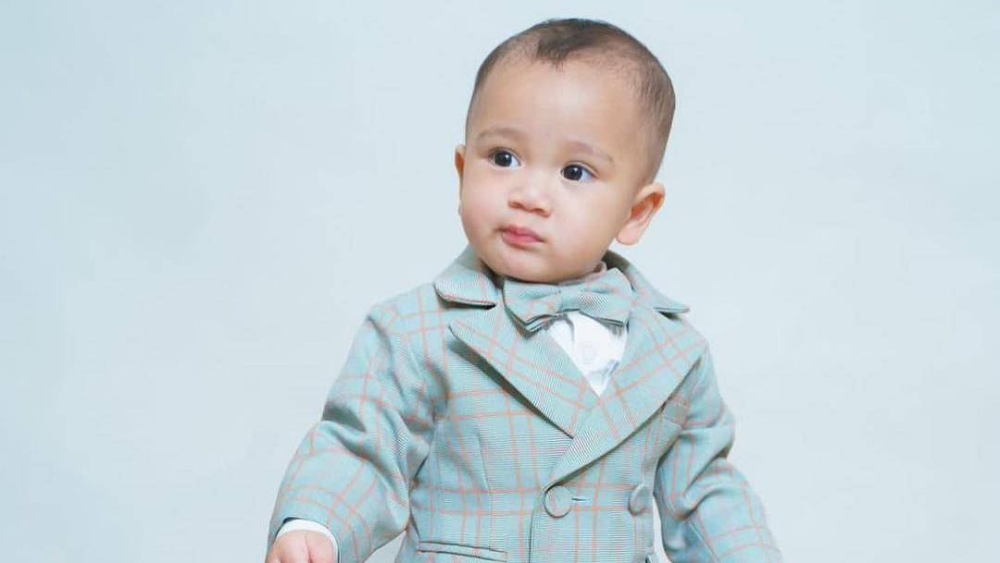

In [53]:
#untuk experiment
week1 = cv.imread('/content/drive/MyDrive/Images/CIPUNK.jpeg')

#print resolusi
tinggi = week1.shape[0]
lebar = week1.shape[1]
print("resolusi image : tinggi x lebar = ",tinggi, "x" ,lebar)
cv2_imshow(week1)

##Garis Horizontal (Manual)


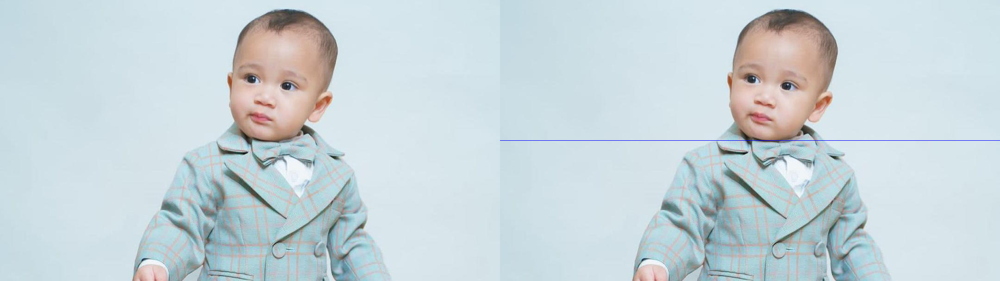

In [54]:
#untuk experiment
exp1 = cv.imread('/content/drive/MyDrive/Images/CIPUNK.jpeg')
#untuk pembanding
pembanding = cv.imread('/content/drive/MyDrive/Images/CIPUNK.jpeg')

for y in range (lebar) : 
  
#mengindikasikan bahwa setiap pixel pada posisi baris ke-tengah (int((tinggi)/2)) 
#dan kolom ke-y pada gambar exp1 akan diganti dengan nilai [255,0,0], yang merupakan kode warna biru.  
  exp1[int((tinggi)/2),y] = [255,0,0]

final_frame = cv.hconcat((pembanding, exp1))
cv2_imshow(final_frame)

##Garis Vertikal (Manual)

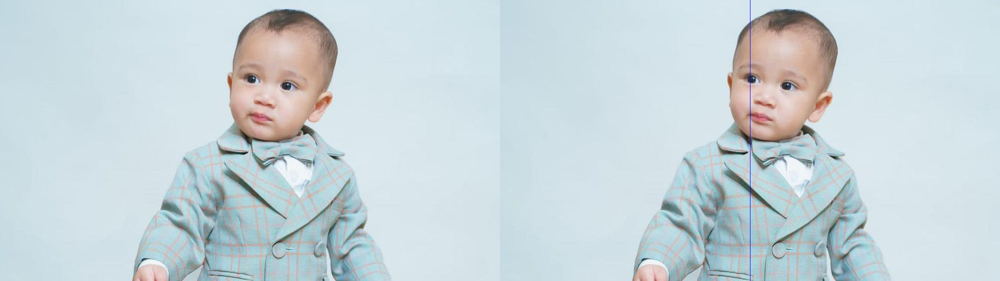

In [55]:
#untuk experiment
exp2 = cv.imread('/content/drive/MyDrive/Images/CIPUNK.jpeg')
#untuk pembanding
pembanding = cv.imread('/content/drive/MyDrive/Images/CIPUNK.jpeg')

for x in range (tinggi):
  
#mengindikasikan bahwa setiap pixel pada posisi baris ke-x dan kolom ke-tengah (int(lebar/2)) 
#pada gambar exp2 akan diganti dengan nilai [255,0,0], yang merupakan kode warna merah.  
    exp2[x, int(lebar/2)] = [255, 0, 0]

final_frame = cv.hconcat((pembanding, exp2))
cv2_imshow(final_frame)

##Garis Menyilang (Manual)

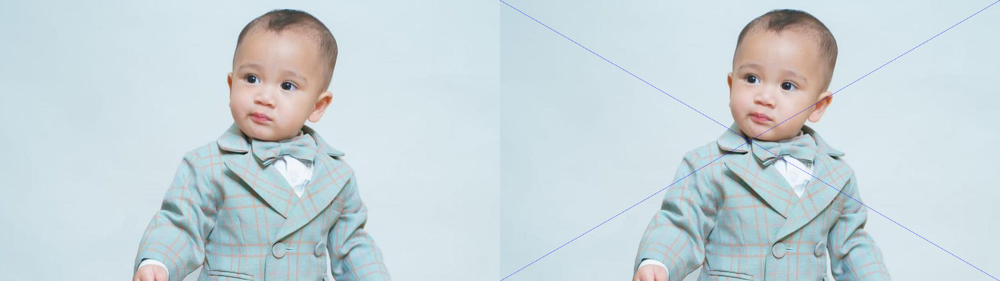

In [56]:
#untuk experiment
exp3 = cv.imread('/content/drive/MyDrive/Images/CIPUNK.jpeg')
#untuk pembanding
pembanding = cv.imread('/content/drive/MyDrive/Images/CIPUNK.jpeg')

for x in range (tinggi):
  
#digunakan untuk mengubah warna piksel pada gambar exp3 pada dua titik diagonal yang 
#membentang dari sudut kiri atas ke sudut kanan bawah dan dari sudut kanan atas ke sudut kiri bawah.  
  exp3[x,int(x*(lebar/tinggi))] = [255,0,0]
  exp3[x,lebar-1-int(x*(lebar/tinggi))] = [255,0,0]

final_frame = cv.hconcat((pembanding, exp3))
cv2_imshow(final_frame)

##Garis Horizontal (Library)

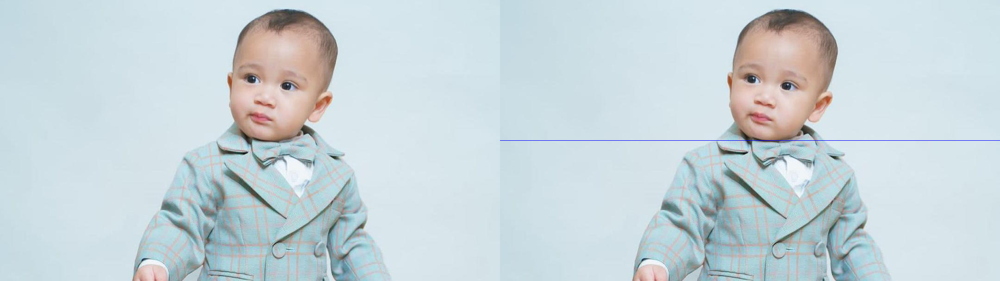

In [57]:
#untuk experiment
exp4 = cv.imread('/content/drive/MyDrive/Images/CIPUNK.jpeg')
#untuk pembanding
pembanding = cv.imread('/content/drive/MyDrive/Images/CIPUNK.jpeg')

#mencari dimension dari images
tinggi, lebar, _ = exp1.shape

# Gambar horizontal image
#(0, int(tinggi/2)) merupakan titik awal garis yang akan digambar. Pada kode tersebut, titik awal garis diatur pada posisi (0, int(tinggi/2)), yaitu pada posisi kiri-tengah gambar.
#(lebar-1, int(tinggi/2)) merupakan titik akhir garis yang akan digambar. Pada kode tersebut, titik akhir garis diatur pada posisi (lebar-1, int(tinggi/2)), yaitu pada posisi kanan-tengah gambar.

cv.line(exp4, (0, int(tinggi/2)), (lebar-1, int(tinggi/2)), (255, 0, 0), thickness=2)

# Concatenate the images horizontally
final_frame = cv.hconcat((pembanding, exp1))
cv2_imshow(final_frame)


##Garis Vertikal (Library)

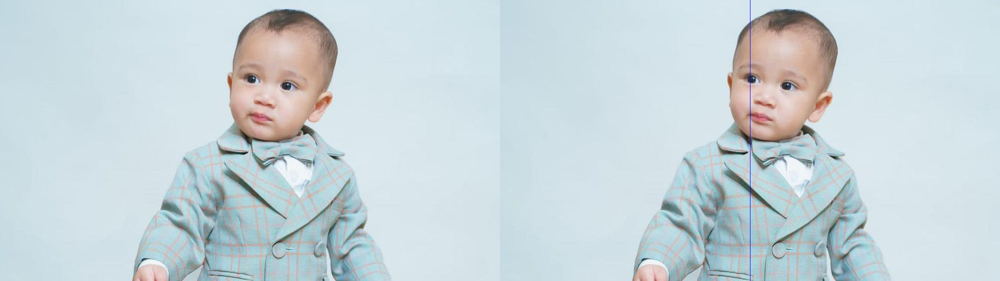

In [58]:
#untuk experiment
exp5 = cv.imread('/content/drive/MyDrive/Images/CIPUNK.jpeg')
#untuk pembanding
pembanding = cv.imread('/content/drive/MyDrive/Images/CIPUNK.jpeg')

# Get the dimensions of the images
tinggi, lebar, _ = exp5.shape

# Gambar vertical line pada image
#(int(lebar/2), 0) merupakan titik awal garis yang akan digambar. Pada kode tersebut, titik awal garis diatur pada posisi tengah atas gambar.
#(int(lebar/2), tinggi-1) merupakan titik akhir garis yang akan digambar. Pada kode tersebut, titik akhir garis diatur pada posisi tengah bawah gambar.

cv.line(exp5, (int(lebar/2), 0), (int(lebar/2), tinggi-1), (255, 0, 0), thickness=1)

# Concatenate the images horizontally
final_frame = cv.hconcat((pembanding, exp5))
cv2_imshow(final_frame)

##Garis Menyilang (Library)

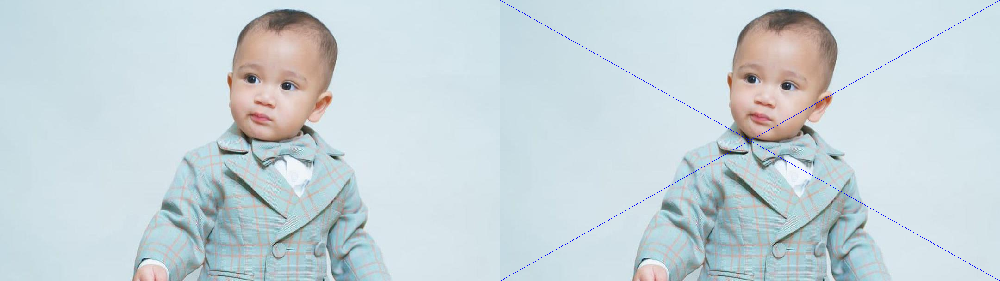

In [59]:
#Resolusi = 609 x 1080
#untuk experiment
exp6 = cv.imread('/content/drive/MyDrive/Images/CIPUNK.jpeg')
#untuk pembanding
pembanding = cv.imread('/content/drive/MyDrive/Images/CIPUNK.jpeg')

line = (0,0)
line2 = (1080,0)

lineend = (1080,609)
lineend2 = (0,609)

cv.line(exp6, line, lineend, (255,0,0), 1)
cv.line(exp6, line2, lineend2, (255,0,0), 1)

final_frame = cv.hconcat((pembanding, exp6))
cv2_imshow(final_frame)

##garis horisontal berwarna putih dibagian tengah gambar dengan panjang tertentu

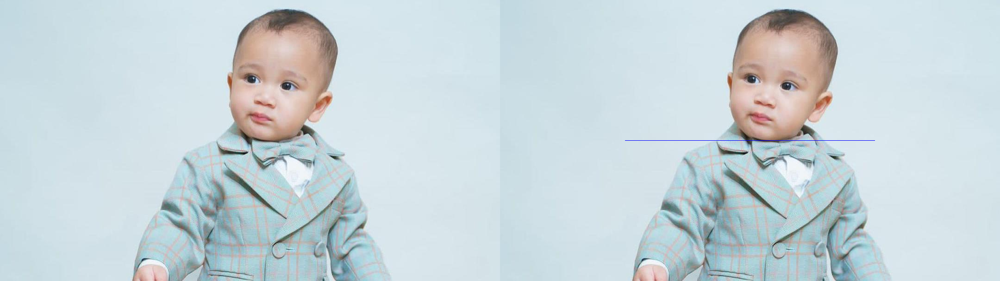

In [60]:
#untuk experiment
exp7 = cv.imread('/content/drive/MyDrive/Images/CIPUNK.jpeg')
#untuk pembanding
pembanding = cv.imread('/content/drive/MyDrive/Images/CIPUNK.jpeg')

#digunakan untuk menghitung batas atas dan bawah dari kolom yang akan diwarnai. 
#Dalam hal ini, kolom yang diwarnai adalah kolom ke-1/4 dan ke-3/4 dari lebar gambar
y1 = int(lebar/4)
y2 = int(lebar/4*3)

#Selanjutnya, perulangan for y in range (y1, y2): akan dijalankan untuk setiap kolom
#yang akan diwarnai, dimulai dari kolom y1 hingga y2.
for y in range (y1, y2):
    exp7[int(tinggi/2), y] = [255, 0, 0]

final_frame = cv.hconcat((pembanding, exp7))
cv2_imshow(final_frame)


##Kumpulan pixel warna putih di sembarang tempat dalam gambar

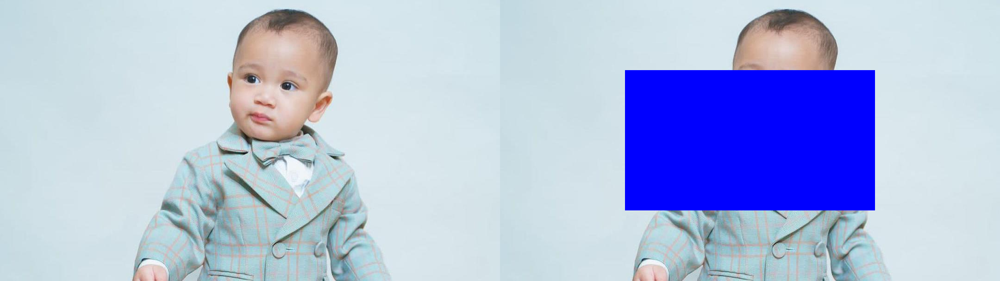

In [61]:
#untuk experiment
exp8 = cv.imread('/content/drive/MyDrive/Images/CIPUNK.jpeg')
#untuk pembanding
pembanding = cv.imread('/content/drive/MyDrive/Images/CIPUNK.jpeg')

#digunakan untuk menghitung batas atas-kiri dan bawah-kanan dari persegi yang akan diwarnai.
#Dalam hal ini, persegi yang diwarnai merupakan persegi pada kuartal tengah dari gambar.
x1, y1 = int(tinggi/4), int(lebar/4)
x2, y2 = int(tinggi/4*3), int(lebar/4*3)


#Selanjutnya, perulangan for x in range (x1, x2): dan for y in range(y1, y2): akan dijalankan untuk setiap piksel dalam persegi yang akan diwarnai.
#Pada setiap iterasi perulangan, kode exp8[x, y] = [255,0,0] akan dijalankan untuk mengubah warna piksel pada posisi (x, y) menjadi warna biru
for x in range (x1, x2):
    for y in range(y1, y2):
        exp8[x, y] = [255,0,0]

final_frame = cv.hconcat((pembanding, exp8))
cv2_imshow(final_frame)

##Membuat garis vertikal tanpa cv line tanpa looping 

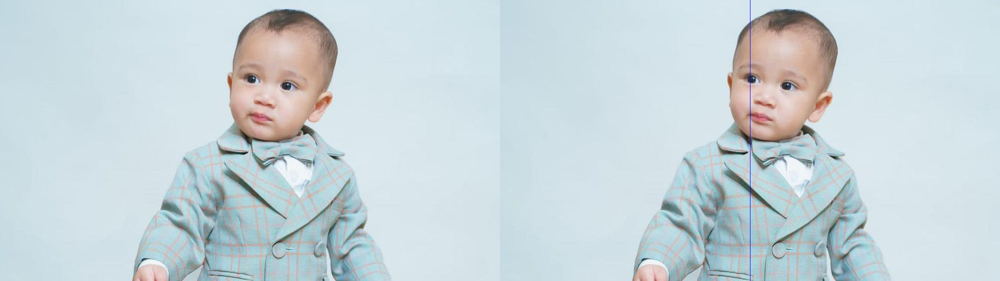

In [62]:
#untuk experiment
exp9 = cv.imread('/content/drive/MyDrive/Images/CIPUNK.jpeg')
#untuk pembanding
pembanding = cv.imread('/content/drive/MyDrive/Images/CIPUNK.jpeg')

tinggi, lebar, _ = exp9.shape

#untuk mengubah warna semua piksel pada kolom tengah gambar exp9 menjadi biru. 
#[:,int(lebar/2)] digunakan untuk memilih semua baris dan kolom ke-lebar/2, 
#digunakan untuk mengatur warna piksel pada baris dan kolom tersebut menjadi biru (R=255, G=0, B=0). 
exp9[:,int(lebar/2)] = [255, 0, 0]

final_frame = cv.hconcat((pembanding, exp9))
cv2_imshow(final_frame)

##Membuat garis horizontal tanpa cv line tanpa looping 

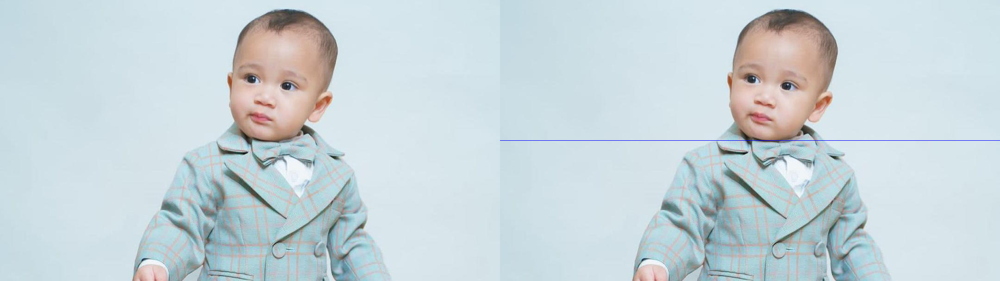

In [63]:
#untuk experiment
exp10 = cv.imread('/content/drive/MyDrive/Images/CIPUNK.jpeg')
#untuk pembanding
pembanding = cv.imread('/content/drive/MyDrive/Images/CIPUNK.jpeg')

tinggi, lebar, _ = exp10.shape

#untuk mengubah warna semua piksel pada kolom tengah gambar exp9 menjadi biru. 
#[int(tinggi/2),:] digunakan untuk memilih semua baris dan kolom ke-tingi/2, 
#digunakan untuk mengatur warna piksel pada baris dan kolom tersebut menjadi biru (R=255, G=0, B=0). 
exp10[int(tinggi/2),:] = [255, 0, 0]

final_frame = cv.hconcat((pembanding, exp10))
cv2_imshow(final_frame)

#BONUS - MEMBERIKAN NOISE

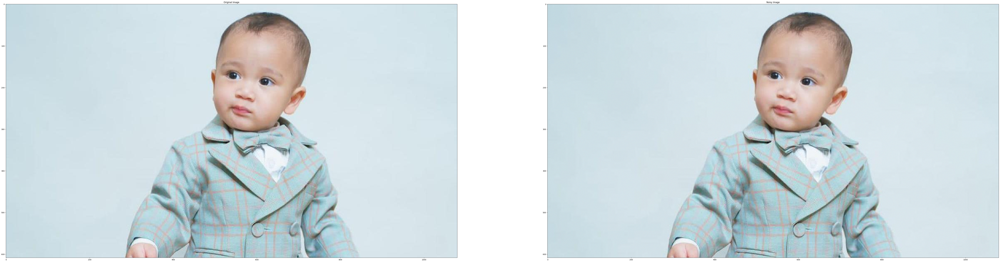

In [67]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# membaca gambar
img = cv2.imread('/content/drive/MyDrive/Images/CIPUNK.jpeg')
imgNew = cv.cvtColor(img,cv.COLOR_BGR2RGB)

# menambahkan Gaussian noise dengan rata-rata 0 dan variansi 0.1
mean = 0
var = 0.1
sigma = var ** 0.5
gaussian = np.random.normal(mean, sigma, imgNew.shape)
noisy_img = imgNew + gaussian

# menampilkan gambar asli dan yang sudah ditambahkan noise
fig, axs = plt.subplots(1, 2, figsize=(100, 50))
axs[0].imshow(imgNew)
axs[0].set_title('Original Image')
axs[1].imshow(noisy_img.astype(np.uint8))
axs[1].set_title('Noisy Image')
plt.show()